In [1]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import colorcet as cc
import community

In [2]:
def prepare_data(nodes_path, edges_path):
    nodes = pd.read_csv(nodes_path)
    edges = pd.read_csv(edges_path)
    nodes['Name']  = nodes['Label'].str.split(' ').str[0]
    return nodes, edges


def create_graph(nodes, edges):
    G = nx.Graph()

    for _, node in nodes.iterrows():
        G.add_node(node['Id'], label=node['Name'], color=node['color'])

    for _, edge in edges.iterrows():
        G.add_edge(edge['Source'], edge['Target'], weight=edge['weight'])
    return G


In [3]:
def add_colors_for_biggest_houses(nodes, threshold=3):
    custom_colors = [
    '#1f77b4',  # blue
    '#ff7f0e',  # orange
    '#2ca02c',  # green
    '#d62728',  # red
    '#9467bd',  # purple
    '#8c564b',  # brown
    '#e377c2',  # pink
    '#7f7f7f',  # gray
    '#bcbd22',  # olive
    '#17becf',  # teal
    '#aec7e8',  # light blue
    '#ffbb78',  # light orange
    '#98df8a',  # light green
    '#ff9896',  # light red
    '#c5b0d5'   # light purple
]

    houses =[nodes['Label'][i].split()[-1] for i in range(len(nodes))]
    # get unique houses
    unique_houses = list(set(houses))
    # get dict of counts for each house
    house_count = {h:houses.count(h) for h in unique_houses if houses.count(h) >= threshold}
    # get different color for each house
    colors = custom_colors[:len(house_count.keys())]

    # create a color map
    color_map = dict(zip(house_count.keys(), colors))
    # create column with color for each node
    nodes['color'] = [color_map[h] if h in house_count.keys() else 'grey' for h in houses]
    
    return nodes, color_map

In [4]:
def create_node_network(nodes_path, edges_path, threshold, k):
    
    nodes, edges = prepare_data(nodes_path, edges_path)
    nodes, color_map = add_colors_for_biggest_houses(nodes, threshold)
    G = create_graph(nodes, edges)

    node_degrees = dict(G.degree(weight='weight'))

    # Increase the figure size
    plt.figure(figsize=(20, 20))

    # Position the nodes using a layout algorithm
    pos = nx.spring_layout(G, k=k)

    # Draw the edges
    nx.draw_networkx_edges(G, pos, alpha=0.2)

    # Draw nodes with sizes proportional to node degree
    node_sizes = [10 * node_degrees[node] for node in G.nodes]
    node_colors = [G.nodes[node]['color'] for node in G.nodes]
    nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.8)

    # Draw labels with fixed size and the node color
    for node, (x, y) in pos.items():
        label = nodes[nodes['Id'] == node]['Name'].values[0]
        plt.text(x, y, label, size=10, color='black', ha='center', va='center')

    # Show the graph with nodes, small labels, and legend
    legend_handles = [plt.Line2D([0], [0], marker='o', markersize=10, label=label, color=color)
                    for label, color in color_map.items()]
    plt.legend(handles=legend_handles, title='Houses')

    plt.axis('off')
    plt.show()


In [216]:
def create_label_network(nodes_path, edges_path, threshold, k):

    nodes, edges = prepare_data(nodes_path, edges_path)
    nodes, color_map = add_colors_for_biggest_houses(nodes, threshold)
    G = create_graph(nodes, edges)

    # Create a dictionary of node degrees
    node_degrees = dict(G.degree(weight='weight'))

    # Increase the figure size
    plt.figure(figsize=(20, 20))

    # Position the nodes using a layout algorithm
    pos = nx.spring_layout(G, k=k)
    # edge size is proportional to the weight of the edge
    edge_sizes = [0.1 * G[u][v]['weight'] for u, v in G.edges]

    # Draw the edges
    nx.draw_networkx_edges(G, pos, alpha=0.2, width=edge_sizes)
    nx.draw_networkx_nodes(G,  pos, node_size=0, alpha=0)

    # Draw labels with sizes proportional to node degree
    for node, (x, y) in pos.items():
        # make label as name of the node
        label = nodes[nodes['Id'] == node]['Name'].values[0]
        label_size = node_degrees[node] * 1/10
        # color the text to the color of the node it represents
        plt.text(x, y, label, size=label_size, color=G.nodes[node]['color'], ha='center', va='center')
    # Show the graph without nodes

    plt.legend(handles=[plt.Line2D([0], [0], marker='o', color=color_map[h], label=h) for h in color_map.keys()])
    plt.axis('off')
    plt.show()

# Book 1

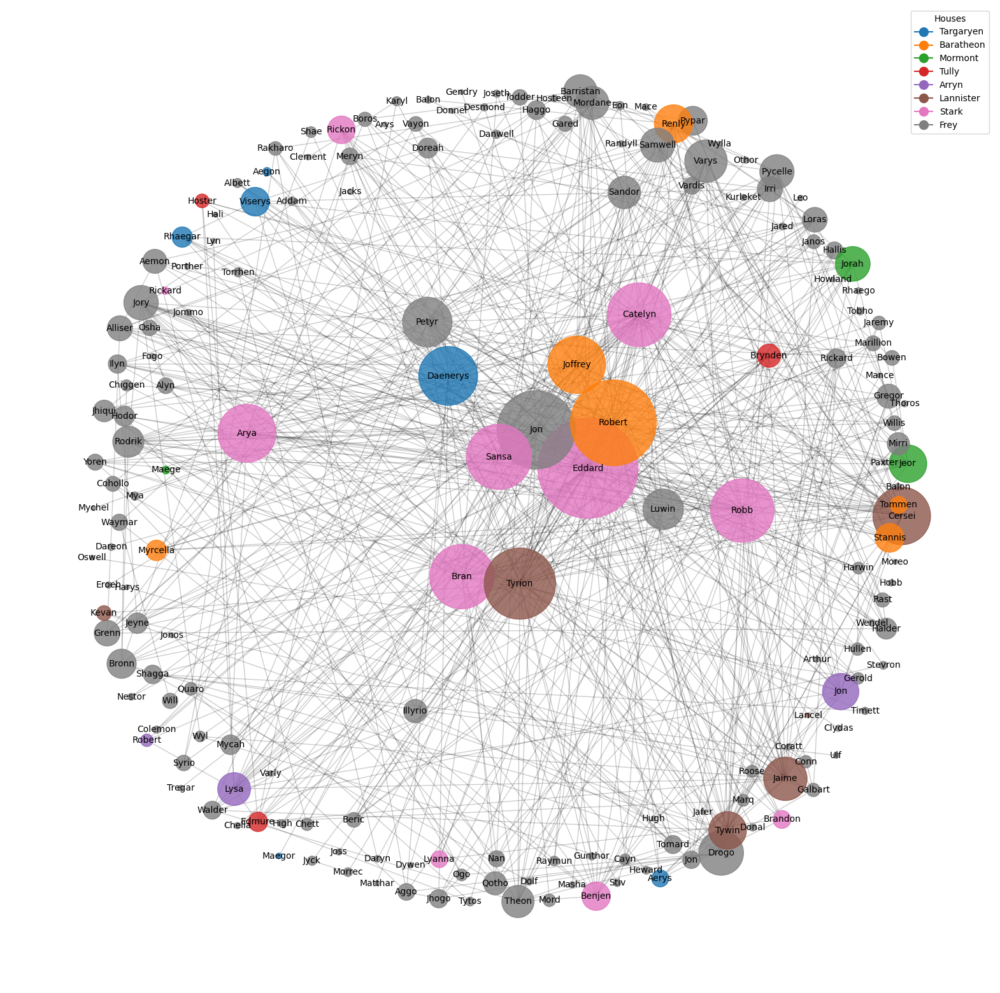

In [202]:
create_node_network('data/game_of_thrones/asoiaf-book1-nodes.csv', 'data/game_of_thrones/asoiaf-book1-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/asoiaf-book1-nodes.csv', 'data/game_of_thrones/asoiaf-book1-edges.csv', 3, 4.5)


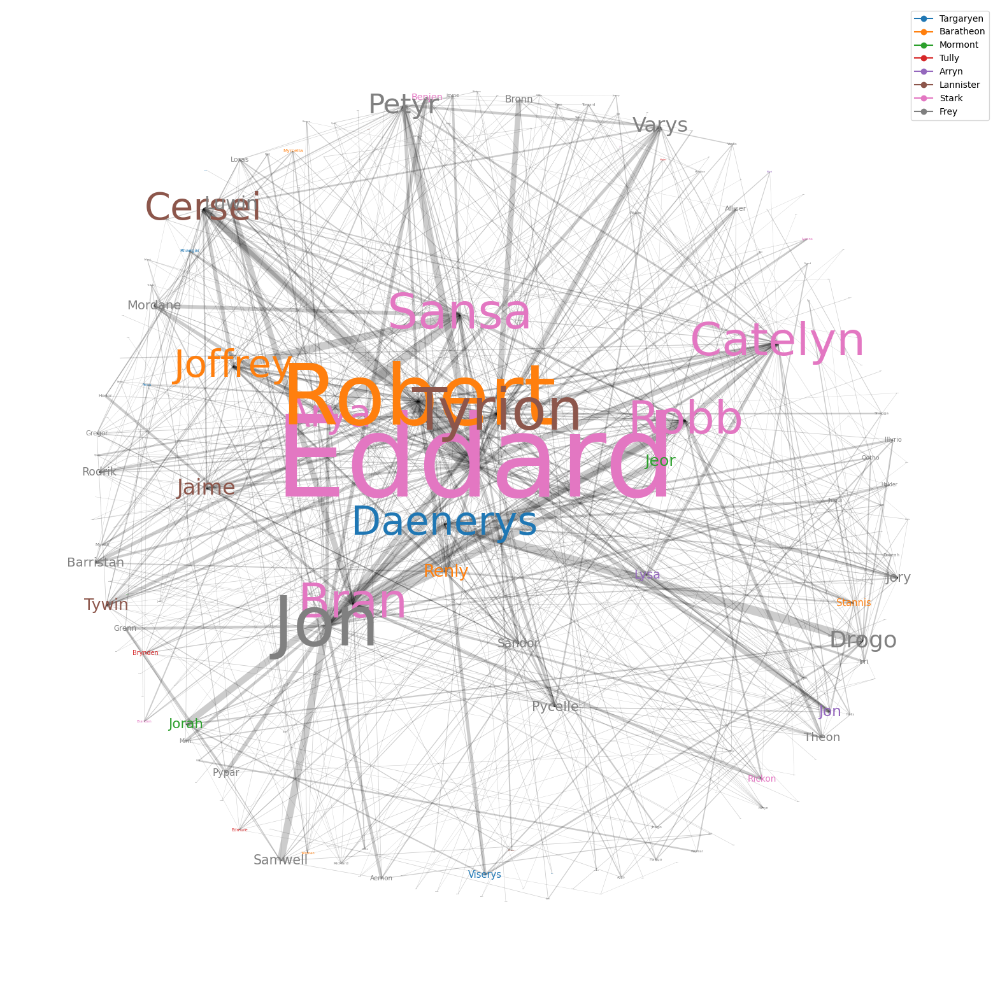

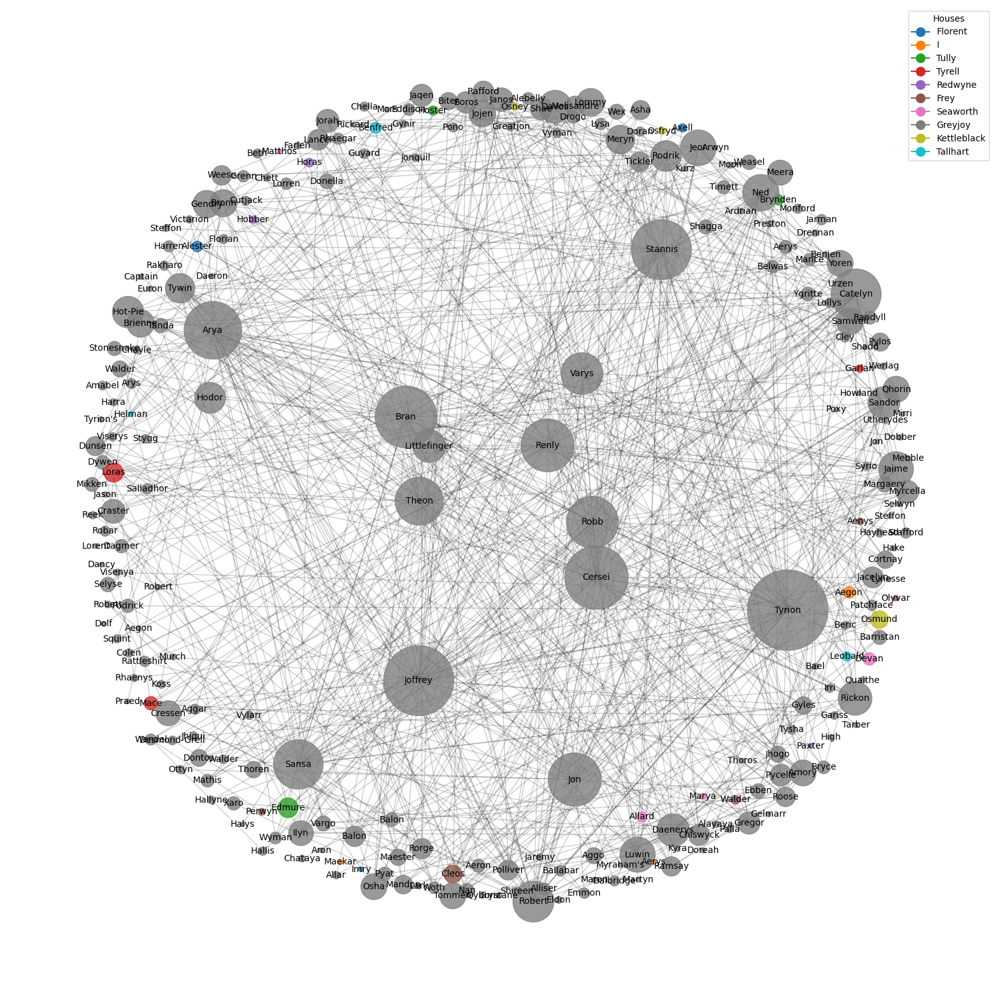

In [203]:
create_node_network('data/game_of_thrones/asoiaf-book2-nodes.csv', 'data/game_of_thrones/asoiaf-book2-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/asoiaf-book2-nodes.csv', 'data/game_of_thrones/asoiaf-book2-edges.csv', 3, 4.5)

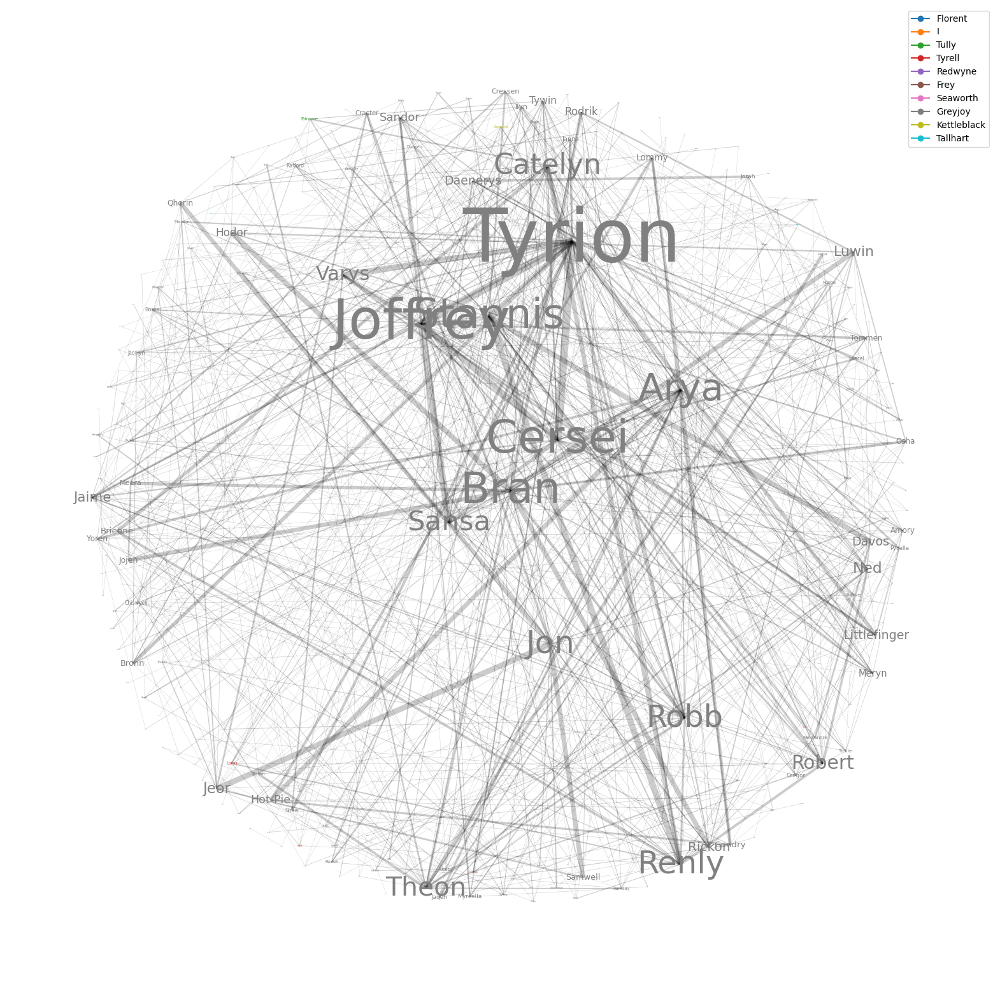

# Book 3

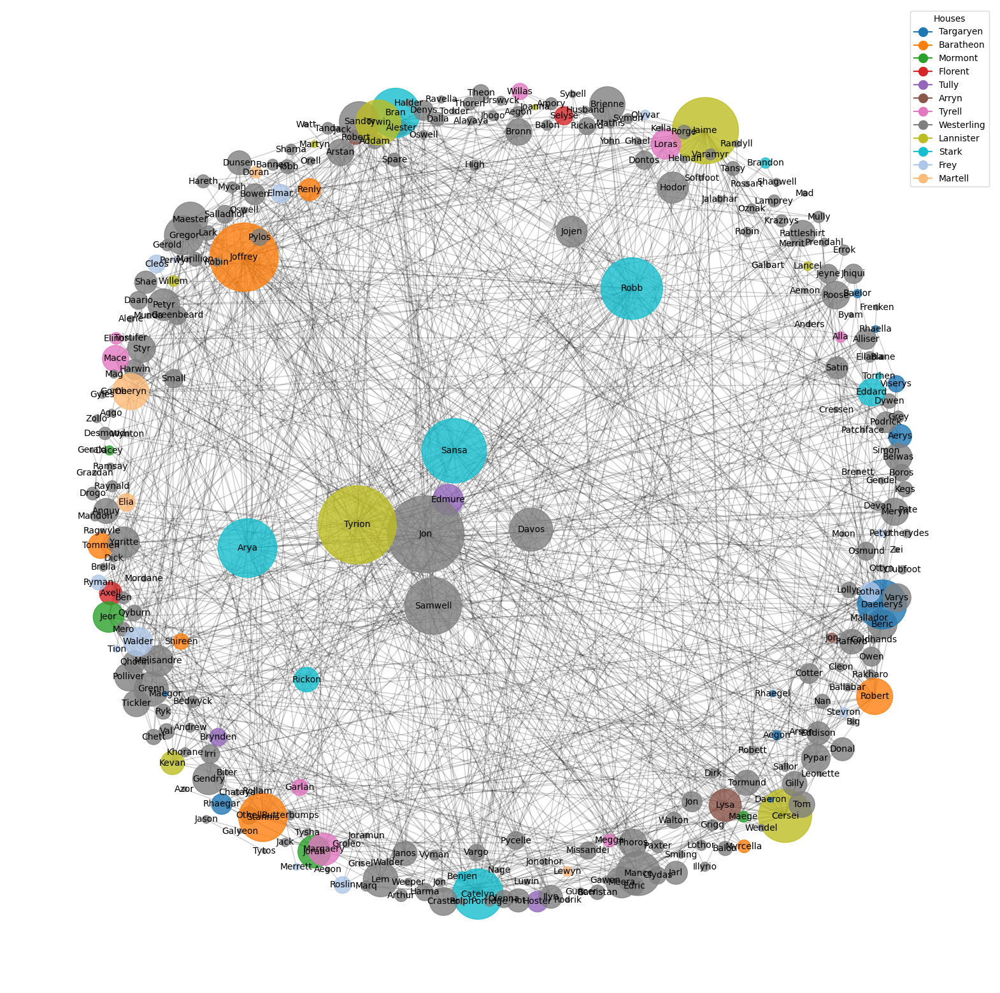

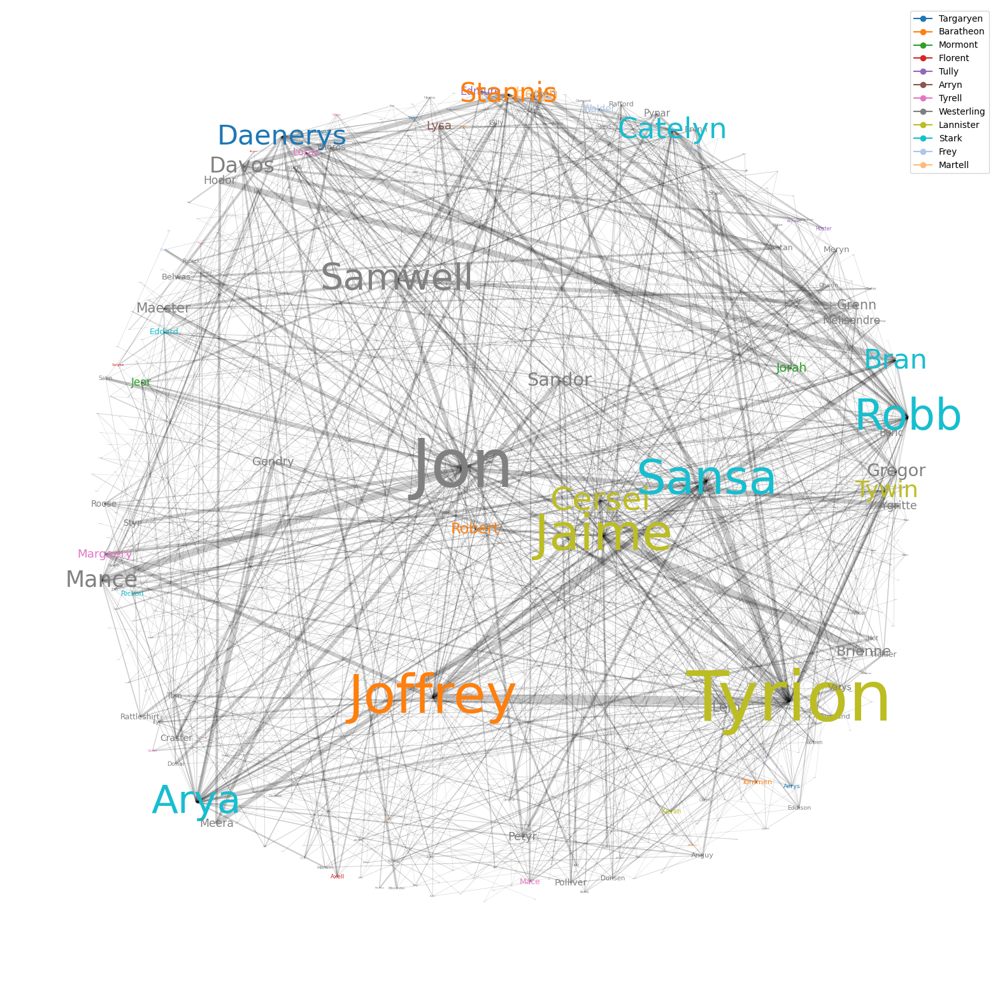

In [205]:
create_node_network('data/game_of_thrones/asoiaf-book3-nodes.csv', 'data/game_of_thrones/asoiaf-book3-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/asoiaf-book3-nodes.csv', 'data/game_of_thrones/asoiaf-book3-edges.csv', 3, 4.5)

# Book 4

In [208]:
create_node_network('data/game_of_thrones/asoiaf-book4-nodes.csv', 'data/game_of_thrones/asoiaf-book4-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/asoiaf-book4-nodes.csv', 'data/game_of_thrones/asoiaf-book4-edges.csv', 3, 4.5)

KeyError: 'Stokeworth'

# Book 5

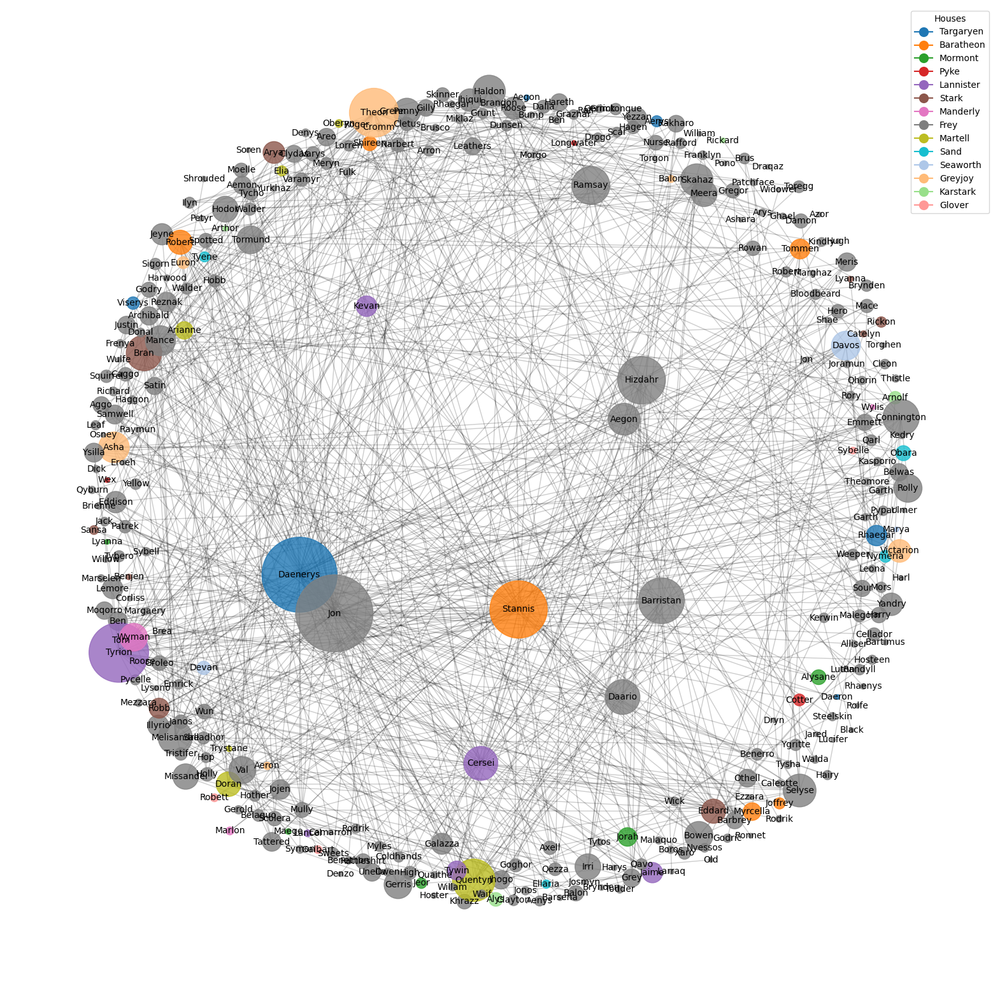

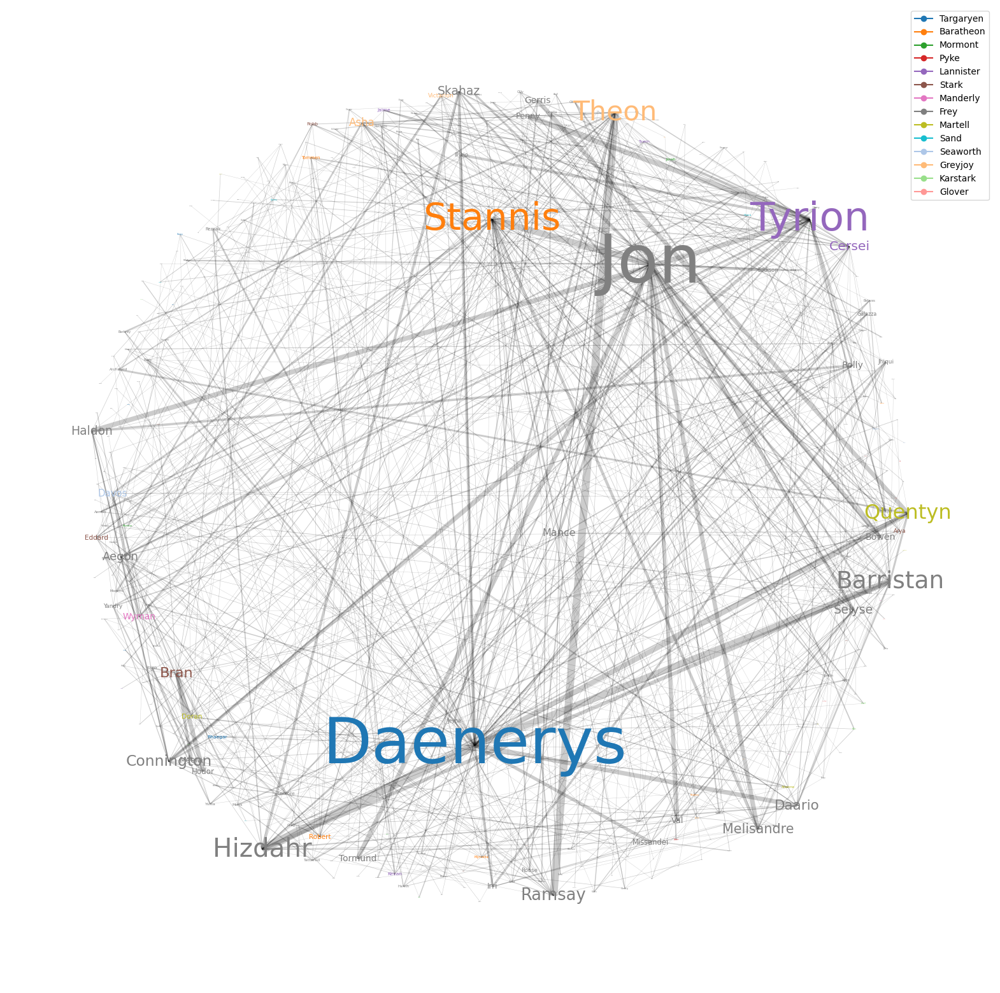

In [207]:
create_node_network('data/game_of_thrones/asoiaf-book5-nodes.csv', 'data/game_of_thrones/asoiaf-book5-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/asoiaf-book5-nodes.csv', 'data/game_of_thrones/asoiaf-book5-edges.csv', 3, 4.5)

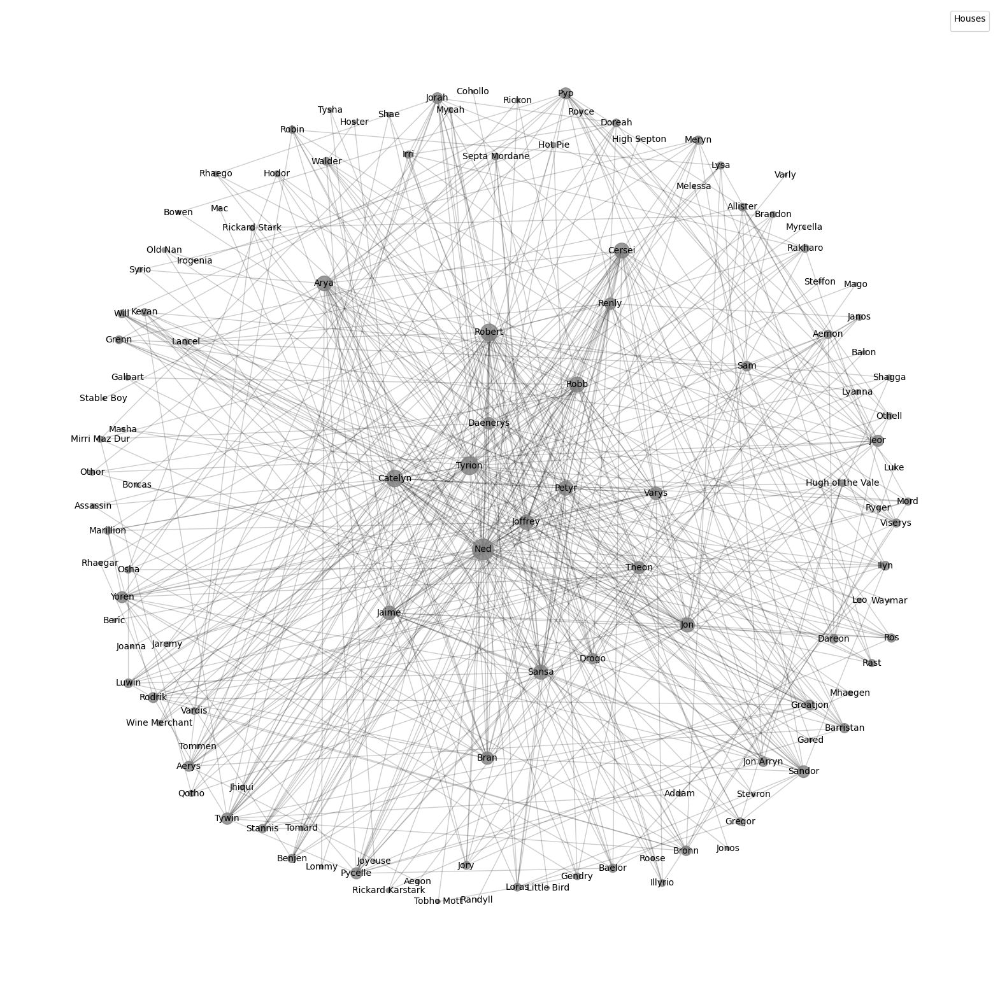

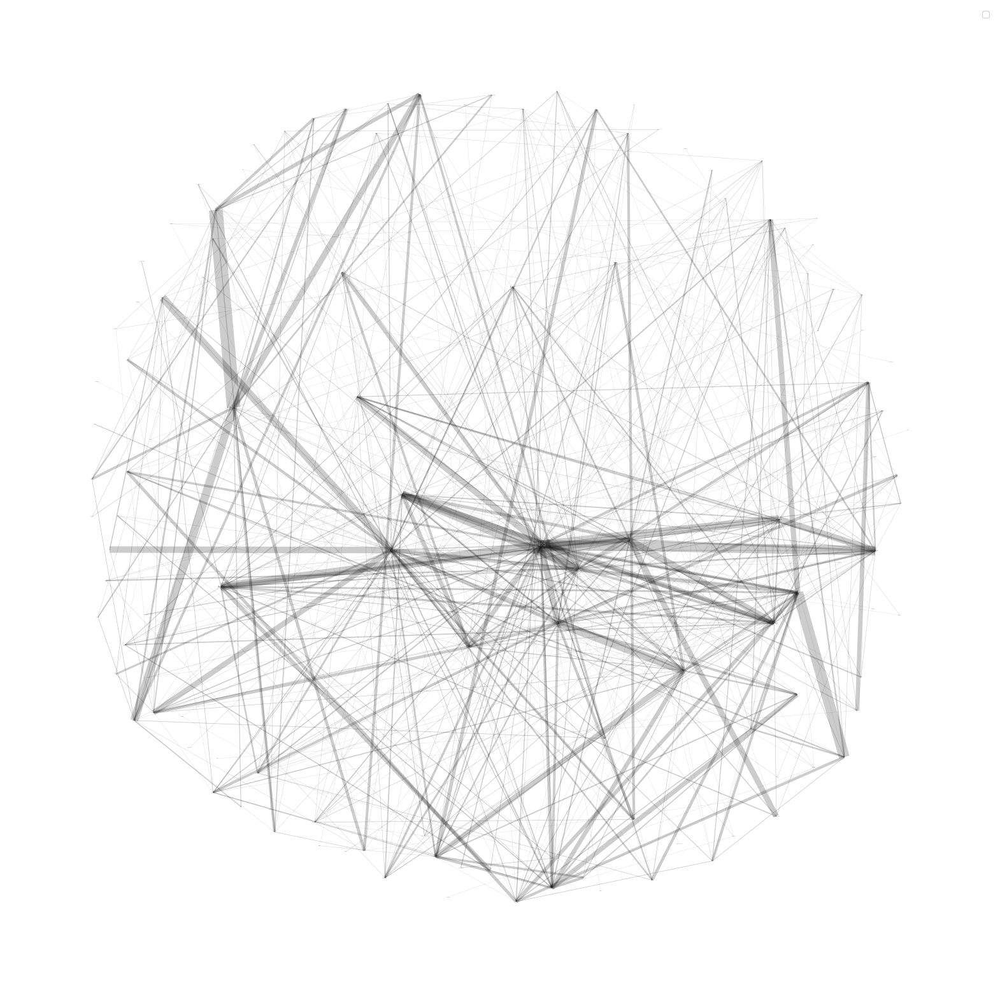

In [217]:
create_node_network('data/game_of_thrones/got-s1-nodes.csv', 'data/game_of_thrones/got-s1-edges.csv', 3, 4.5)
create_label_network('data/game_of_thrones/got-s1-nodes.csv', 'data/game_of_thrones/got-s1-edges.csv', 3, 4.5)

# Task 2

In [233]:
def get_histogram_of_degrees(node_path, edge_path, title):

    nodes, edges = prepare_data(node_path, edge_path)
    G = nx.Graph()

    for _, node in nodes.iterrows():
        G.add_node(node['Id'], label=node['Name'])

    for _, edge in edges.iterrows():
        G.add_edge(edge['Source'], edge['Target'], weight=edge['weight'])


    degrees = [G.degree(n) for n in G.nodes()]
    plt.hist(degrees)
    plt.title(title)
    plt.show()


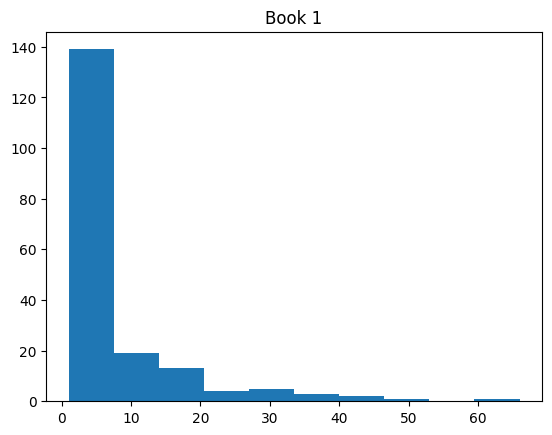

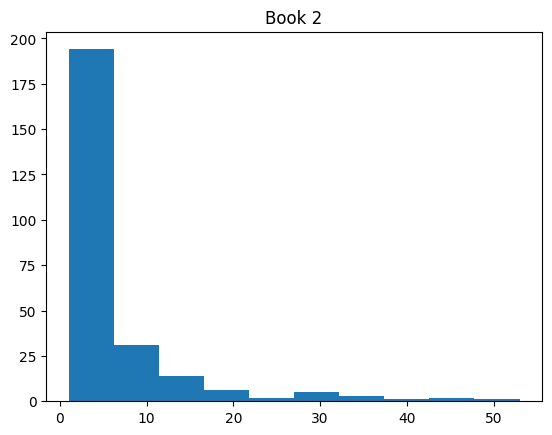

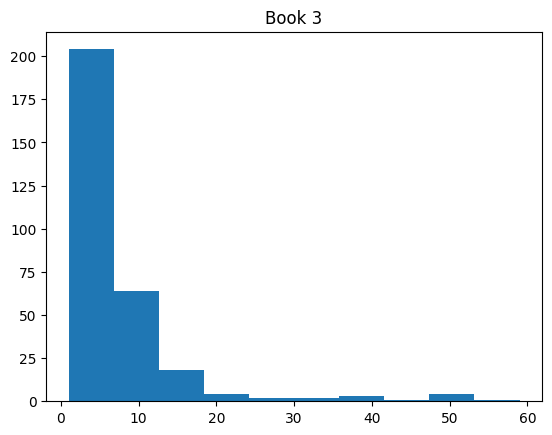

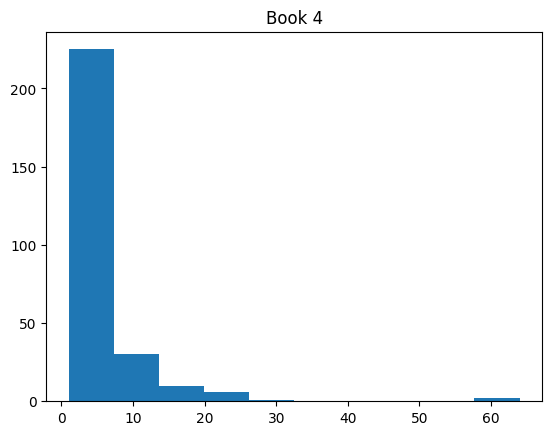

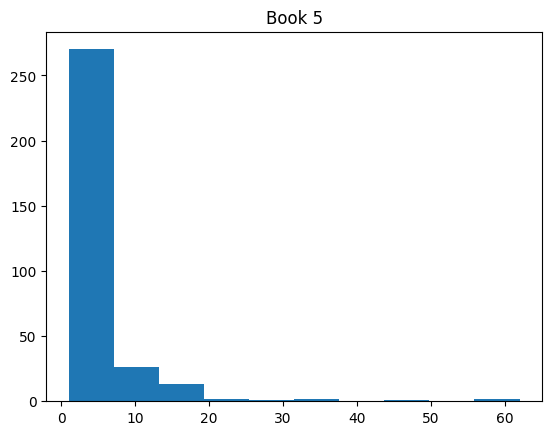

In [234]:
for i in range(1, 6):
    get_histogram_of_degrees(f'data/game_of_thrones/asoiaf-book{i}-nodes.csv', f'data/game_of_thrones/asoiaf-book{i}-edges.csv', f'Book {i}')

# Transportation

In [75]:
import numpy as np
import math

In [190]:
# read .txt file with pandas
def read_txt(path):
    df = pd.read_csv(path, sep=' ', header=None)
    df.columns = ['Source', 'Target', 'weight']
    # normalize weights
    df['weight'] = df['weight'] / df['weight'].min()
    # apply exponential function to weights
    # df['weight'] = df['weight'].apply(lambda x: math.exp(-x))
    return df

# pick
data = read_txt('data/reachability.txt')
data = data[:1800]

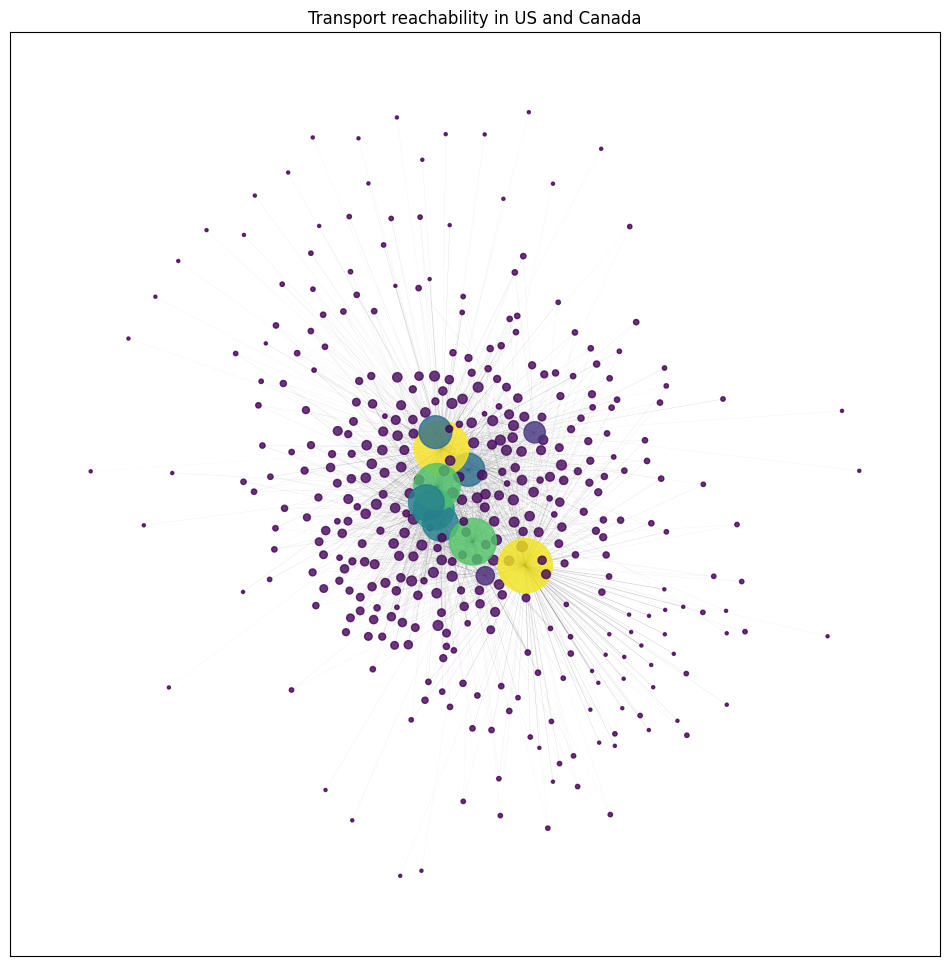

In [191]:
# create graph
G = nx.Graph()
nx.from_pandas_edgelist(data, 'Source', 'Target', create_using=G, edge_attr='weight')
# draw graph

plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G)
node_degrees = dict(G.degree())
node_sizes = [5 * node_degrees[node] for node in G.nodes]

edge_sizes = [1 * G[u][v]['weight'] for u, v in G.edges]

# colors corresponding to size of node

# color nodes according to cmap

nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_sizes, alpha=0.8 )

# adjust width of edges
nx.draw_networkx_edges(G, pos, alpha=0.2, width=edge_sizes)
plt.title('Transport reachability in US and Canada')
# colors corresponding to size of node

plt.show()


# Star Wars

In [112]:
nodes = pd.read_csv('data\\star_wars\\starwars-characters.csv')
edges = pd.read_csv('data\\star_wars\\starwars-links.csv')

G = nx.Graph()

for _, node in nodes.iterrows():
    G.add_node(node['number'], label=node['name'])

for _, edge in edges.iterrows():
    G.add_edge(edge['character1'], edge['character2'], weight=edge['scenes'])

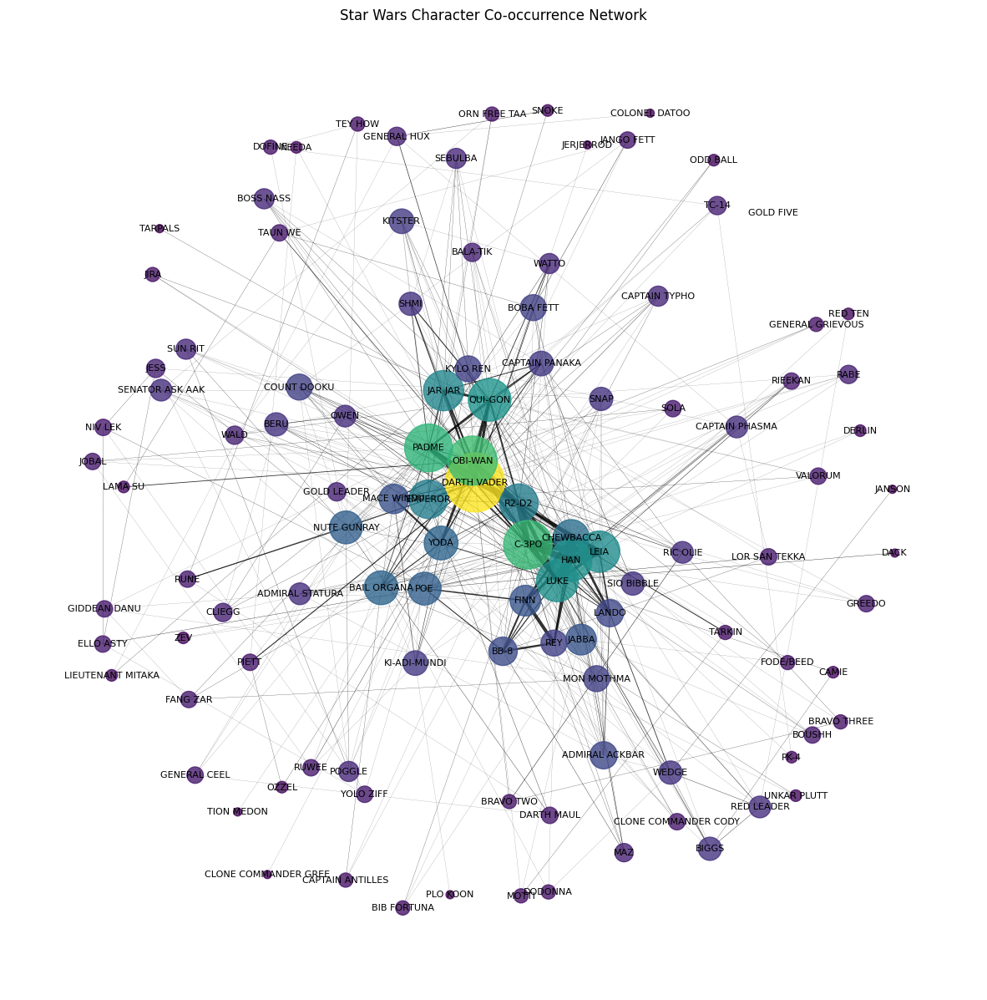

In [117]:
node_degrees = dict(G.degree(weight='scenes'))

plt.figure(figsize=(15, 15))

# Position the nodes using a layout algorithm
pos = nx.spring_layout(G, k=1.2)

# Draw nodes with sizes proportional to node degree
node_sizes = [50 * node_degrees[node] for node in G.nodes]
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, alpha=0.8, node_color=node_sizes)
# Width of edges is proportional to the weight of the edges
edge_sizes = [0.1 * G[u][v]['weight'] for u, v in G.edges]
nx.draw_networkx_edges(G, pos, width=edge_sizes, alpha=0.8)
# Draw labels with fixed size and the node color
for node, (x, y) in pos.items():
    label = nodes[nodes['number'] == node]['name'].values[0]
    plt.text(x, y, label, size=8, color='black', ha='center', va='center')

plt.title('Star Wars Character Co-occurrence Network')
plt.axis('off')
plt.show()
